author: sjones, rlutt

In [1]:
import numpy as np
import matplotlib.pyplot as pp

Part 1: Question 1

In [2]:
np.random.rand(3,2)

array([[ 0.86169147,  0.49222827],
       [ 0.98265306,  0.696878  ],
       [ 0.25925367,  0.78940688]])

Part 1: Question 2

In [3]:
np.reshape(np.arange(1,13), (4,3))

array([[ 1,  2,  3],
       [ 4,  5,  6],
       [ 7,  8,  9],
       [10, 11, 12]])

Part 1: Question 3

In [4]:
def fade_row(N):
    return (np.reshape(np.arange(0,1,(1/N)), (1,N)))

fade_row(5).shape

(1, 5)

Part 1: Question 4

In [5]:
np.reshape(np.arange(0, 120), (10,12))[0:4,8:12]

array([[ 8,  9, 10, 11],
       [20, 21, 22, 23],
       [32, 33, 34, 35],
       [44, 45, 46, 47]])

Part 1: Question 5

(200, 100)

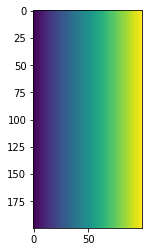

In [6]:
def fade_left(M,N):
    mat = fade_row(N)
    for i in range(1, M):
        mat = np.vstack((mat, fade_row(N)))
    return (mat)

matrix = fade_left(200, 100)
pp.imshow(matrix)
matrix.shape

Part 1: Question 6

(-0.5, 637.5, 418.5, -0.5)

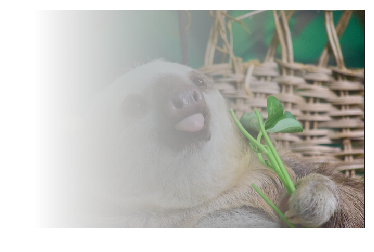

In [9]:
def fade_img_left(img):
    M = blep.shape[0]
    N = blep.shape[1]
    D = blep.shape[2]
    matrix = fade_left(M, N)
    for i in range(0, D):
        img[:,:,i] *= matrix
    return (img)

blep = pp.imread("blep.png")
pp.imshow(fade_img_left(blep))
pp.axis("off")

Part 2: helper functions

In [222]:
def split_color(img):
    r = img[:,:,0]
    g = img[:,:,1]
    b = img[:,:,2]
    return (r, g, b)

def merge_color(r, g, b):
    img = np.stack([r, g, b], axis=2)
    return (img)

def get_shape(img):
    m = img.shape[0]
    n = img.shape[1]
    d = img.shape[2]
    return (m, n, d)

def show_blep(fun):
    pp.imshow(fun(pp.imread("blep.png")))
    pp.axis("off")
    
def normal_blep():
    pp.imshow(pp.imread("blep.png"))
    pp.axis("off")
    
def diff_blep(fun):
    fig = pp.figure(figsize=(20,20))
    fig.add_subplot(1,2,1)
    pp.axis("off")
    blep = pp.imread("blep.png")
    pp.imshow(blep)
    fig.add_subplot(1,2,2)
    pp.axis("off")
    pp.imshow(fun(blep))
    
def circle_mask(M, N):
    mask = np.ones((M,N))
    for x in range(0, M):
        for y in range(0, N):
            mask[x][y] = 1 - (((((y + .5) - (N / 2)) * ((y + .5) - (N / 2)))  / (N * N)) + ((((x + .5) - (M / 2)) * ((x + .5) - (M / 2))) / (M * M)))
    return(mask)

Part 2: red tonal

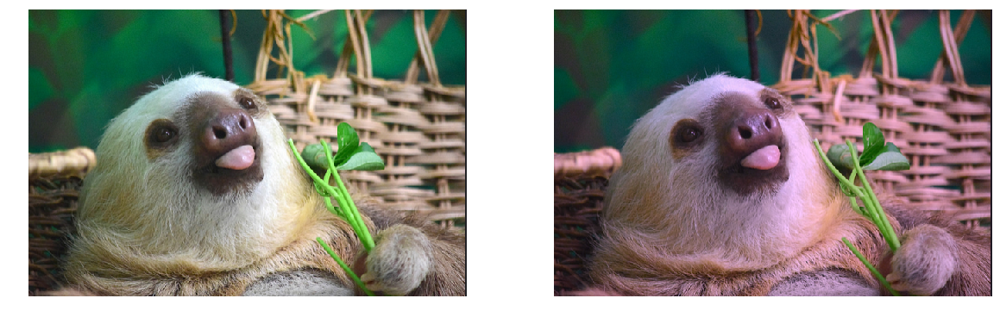

In [223]:
def redish(img):
    redish = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * .8
    for i in range(1, 2):
        redish[:,:,i] *= matrix
    return (redish)

diff_blep(redish)

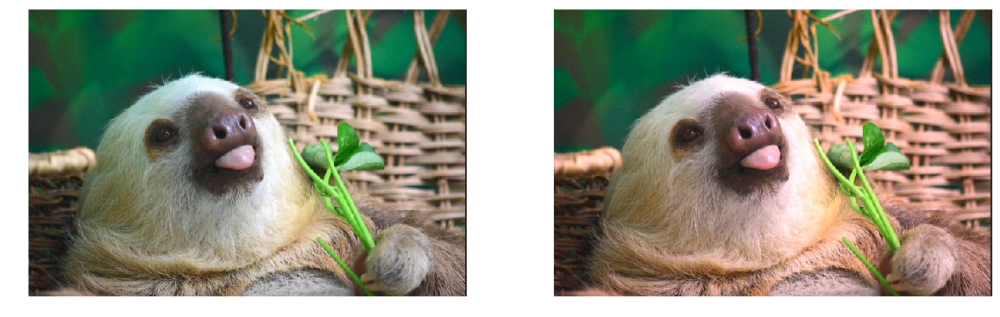

In [224]:
def redder(img):
    redder = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * 1.2
    redder[:,:,0] *= matrix
    for x in range(0, M):
        for y in range(0, N):
            if redder[x][y][0] > 1:
                redder[x][y][0] = 1
    return (redder)

diff_blep(redder)

Part 2: green tonal

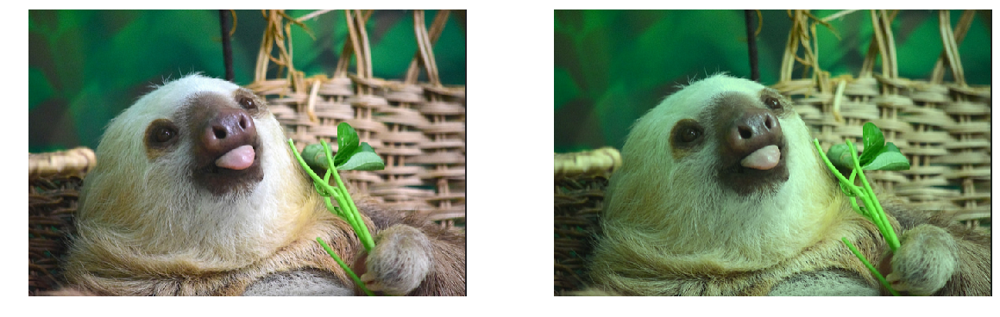

In [225]:
def greenish(img):
    greenish = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * .8
    for i in range(0, 3):
        if i == 1:
            continue
        greenish[:,:,i] *= matrix
    return (greenish)

diff_blep(greenish)

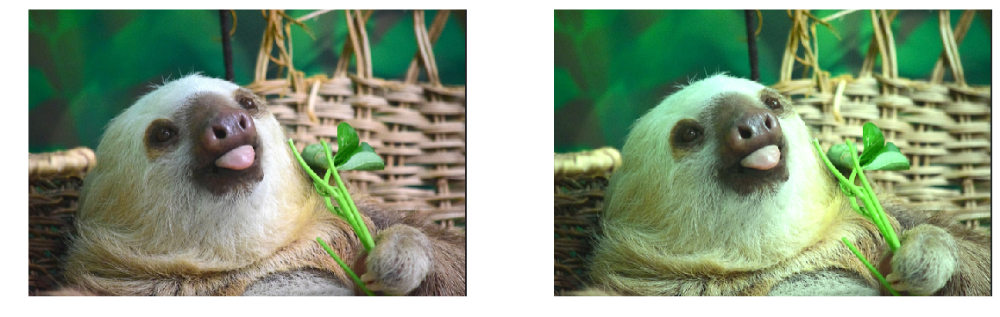

In [227]:
def greener(img):
    greener = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * 1.2
    greener[:,:,1] *= matrix
    for x in range(0, M):
        for y in range(0, N):
            if greener[x][y][1] > 1:
                greener[x][y][1] = 1
    return (greener)

diff_blep(greener)

Part 2: blue tonal

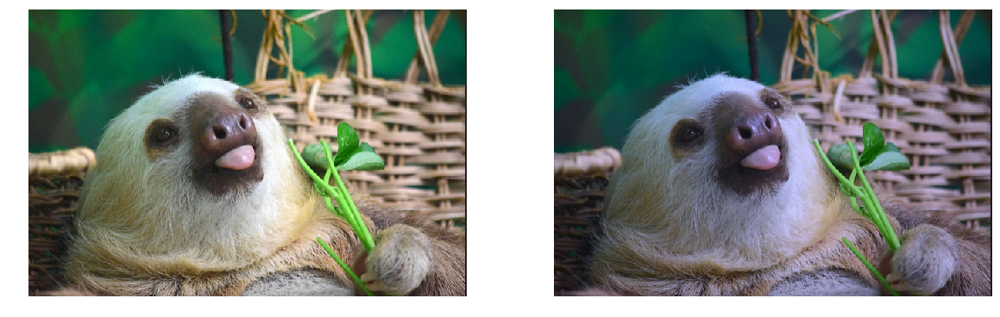

In [228]:
def bluish(img):
    bluish = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * .8
    for i in range(0, 2):
        bluish[:,:,i] *= matrix
    return (bluish)

diff_blep(bluish)

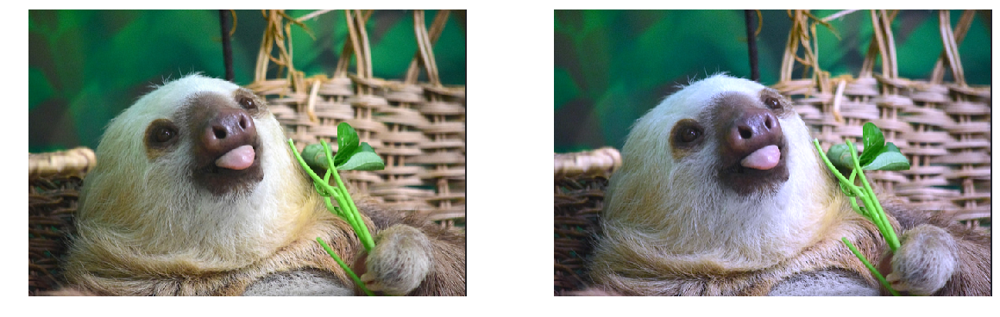

In [229]:
def bluer(img):
    bluer = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * 1.2
    bluer[:,:,2] *= matrix
    for x in range(0, M):
        for y in range(0, N):
            if bluer[x][y][2] > 1:
                bluer[x][y][2] = 1
    return (bluer)

diff_blep(bluer)

Part 2: yellow tonal

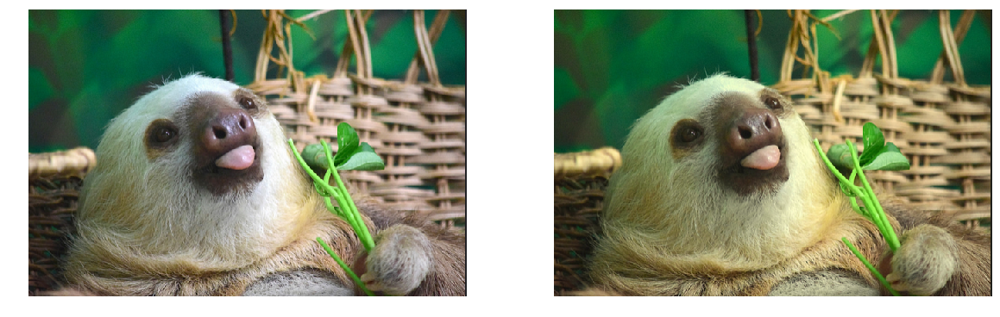

In [230]:
def yellowish(img):
    yellowish = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * .8
    yellowish[:,:,2] *= matrix
    return (yellowish)

diff_blep(yellowish)

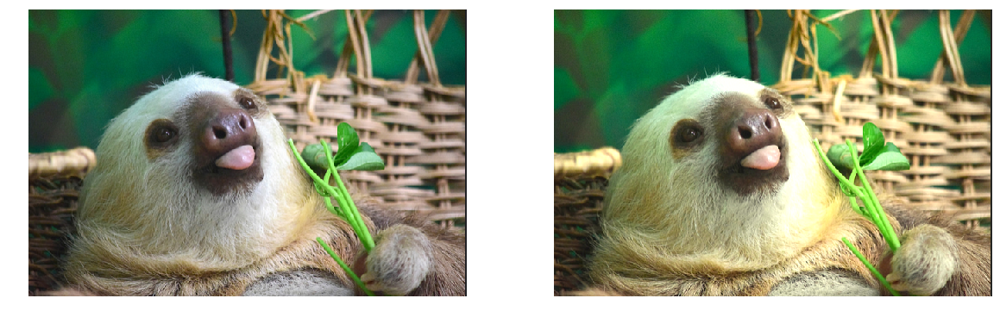

In [231]:
def yellower(img):
    yellower = img
    M, N, D = get_shape(img)
    matrix = np.ones((M,N)) * 1.2
    for i in range(0,2):
        yellower[:,:,i] *= matrix
        for x in range(0, M):
            for y in range(0, N):
                if yellower[x][y][i] > 1:
                    yellower[x][y][i] = 1
    return (yellower)

diff_blep(yellower)

Part 2: greyscale

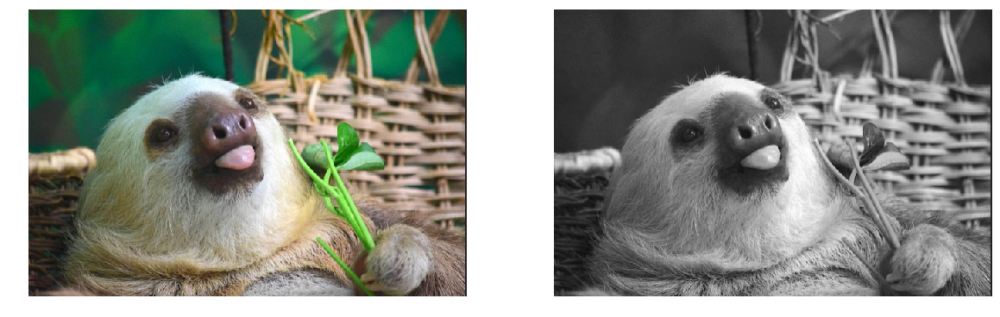

In [232]:
def true_greyscale(img):
    R, G, B = split_color(img)
    M, N, D = get_shape(img)
    grey = np.ones(img.shape)
    for d in range(0, D - 1):
        for x in range(0, M):
            for y in range(0, N):
                grey[x][y][d] = ((R[x][y]) + (G[x][y]) + (B[x][y])) / 3
    return (grey)

diff_blep(true_greyscale)

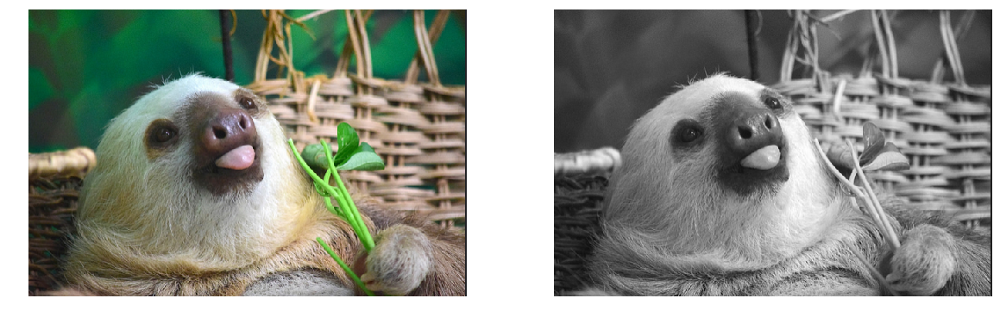

In [233]:
def natural_greyscale(img):
    R, G, B = split_color(img)
    M, N, D = get_shape(img)
    grey = np.ones(img.shape)
    for d in range(0, D - 1):
        for x in range(0, M):
            for y in range(0, N):
                grey[x][y][d] = (0.21 * R[x][y]) + (0.72 * G[x][y]) + (0.07 * B[x][y])
    return (grey)

diff_blep(natural_greyscale)

Part 2: sepia

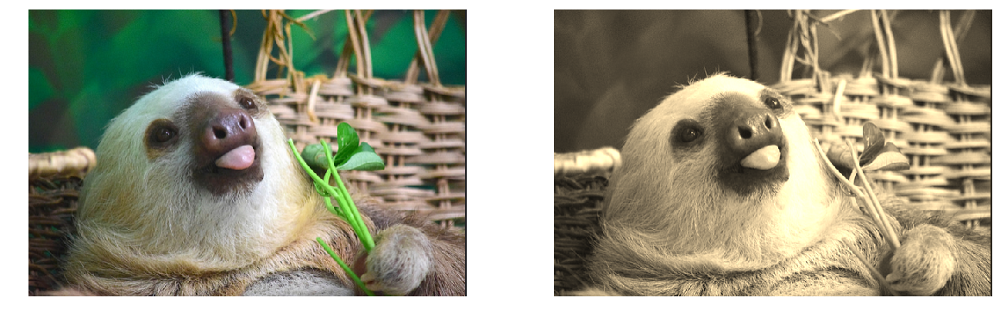

In [234]:
def sepia(img):
    R, G, B = split_color(img)
    M, N, D = get_shape(img)
    sepia = np.ones(img.shape)
    for d in range(0, D - 1):
        for x in range(0, M):
            for y in range(0, N):
                if (d == 0):
                    sepia[x][y][d] = (R[x][y] * 0.393) + (G[x][y] * 0.769) + (B[x][y] * 0.189)
                    if sepia[x][y][d] > 1:
                        sepia[x][y][d] = 1
                elif(d == 1):
                    sepia[x][y][d] = (R[x][y] * 0.349) + (G[x][y] * 0.686) + (B[x][y] * 0.168)
                    if sepia[x][y][d] > 1:
                        sepia[x][y][d] = 1
                elif(d == 2):
                    sepia[x][y][d] = (R[x][y] * 0.272) + (G[x][y] * 0.534) + (B[x][y] * 0.131)
                    if sepia[x][y][d] > 1:
                        sepia[x][y][d] = 1
    return(sepia)

diff_blep(sepia)

Part 2: lighter and darker

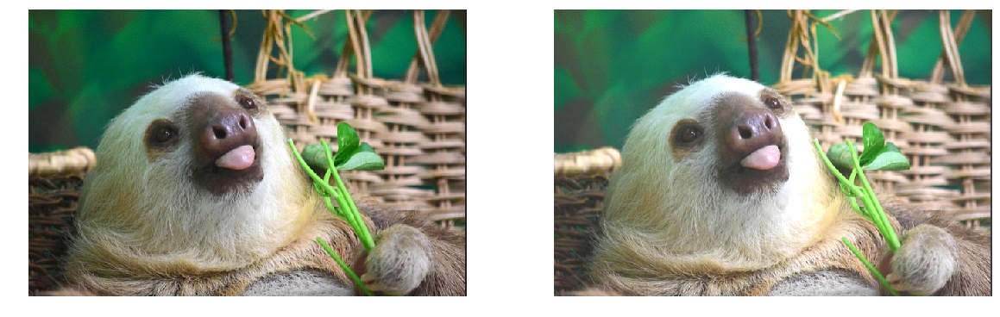

In [235]:
def lighter(img):
    M, N, D = get_shape(img)
    lighter = img
    lighten = np.ones((M,N)) * .1
    for d in range(0, 3):
        lighter[:,:,d] += lighten
        for x in range (0, M):
            for y in range (0, N):
                if (lighter[x][y][d] > 1):
                    lighter[x][y][d] = 1
    return(lighter)

diff_blep(lighter)

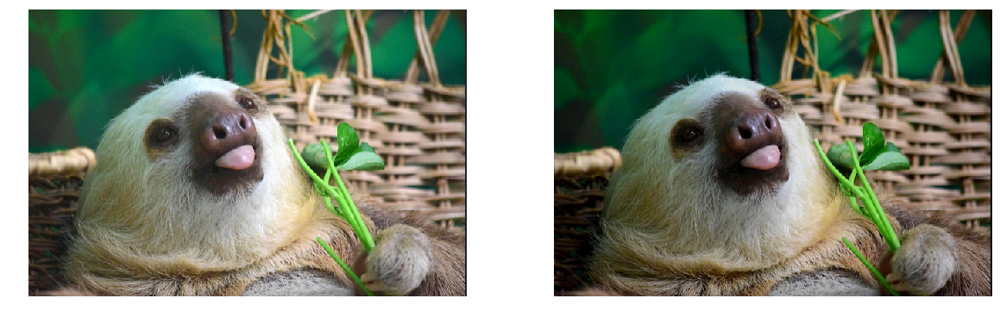

In [236]:
def darker(img):
    M, N, D = get_shape(img)
    darker = img
    darken = np.ones((M,N)) * .1
    for d in range(0, 3):
        darker[:,:,d] -= darken
        for x in range (0, M):
            for y in range (0, N):
                if (darker[x][y][d] < 0):
                    darker[x][y][d] = 0
    return(darker)

diff_blep(darker)

Part 2: contrast

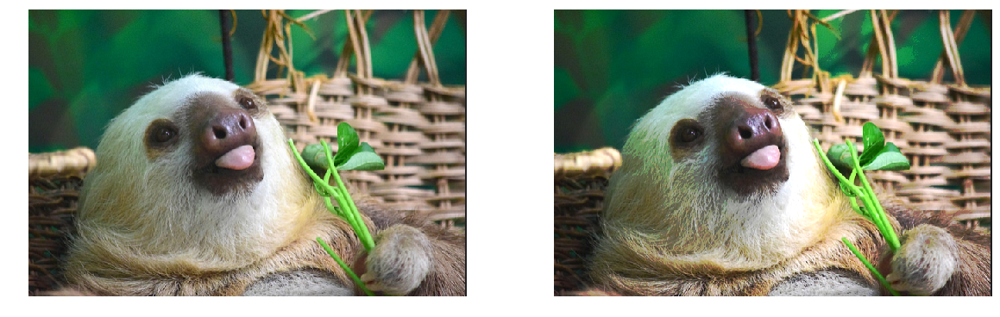

In [237]:
def more_contrast(img):
    contrast = img
    M, N, D = get_shape(img)
    for d in range(0, 3):
        for x in range(0, M):
            for y in range(0, N):
                if (contrast[x][y][d] < .5):
                    contrast[x][y][d] *= .9
                    if (contrast[x][y][d] < 0):
                        contrast[x][y][d] = 0
                if (contrast[x][y][d] > .5):
                    contrast[x][y][d] *= 1.1
                    if (contrast[x][y][d] > 1):
                        contrast[x][y][d] = 1
    return(contrast)

diff_blep(more_contrast)

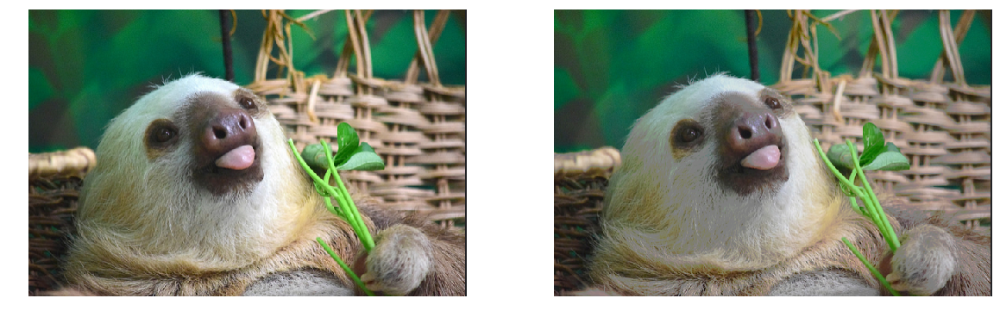

In [238]:
def less_contrast(img):
    contrast = img
    M, N, D = get_shape(img)
    for d in range(0, 3):
        for x in range(0, M):
            for y in range(0, N):
                if (contrast[x][y][d] < .5):
                    contrast[x][y][d] *= 1.1
                    if (contrast[x][y][d] > .5):
                        contrast[x][y][d] = .5
                if (contrast[x][y][d] > .5):
                    contrast[x][y][d] *= .9
                    if (contrast[x][y][d] < .5):
                        contrast[x][y][d] = .5
    return(contrast)

diff_blep(less_contrast)

Part 2: darken and lighten edges

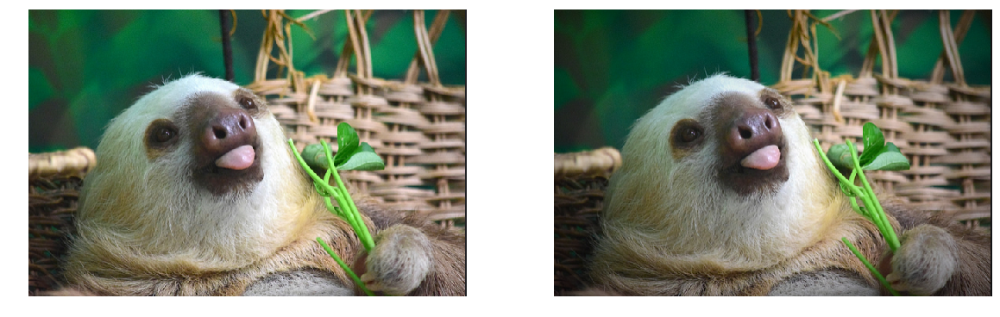

In [239]:
def darken_edges(img):
    dark = img
    M, N, D = get_shape(img)
    darker = circle_mask(M,N)
    for d in range (0, D - 1):
        dark[:,:,d] *= darker
    return (dark)

diff_blep(darken_edges)

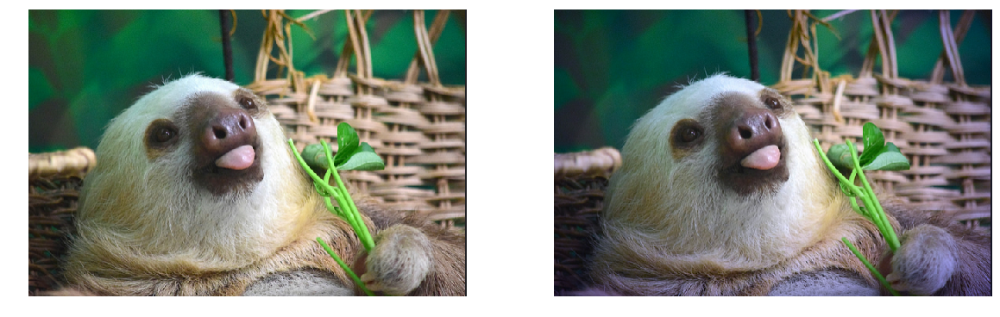

In [240]:
def bluer_edges(img):
    dark = img
    M, N, D = get_shape(img)
    darker = circle_mask(M,N)
    for d in range (0, 2):
        dark[:,:,d] *= darker
    return (dark)

diff_blep(bluer_edges)

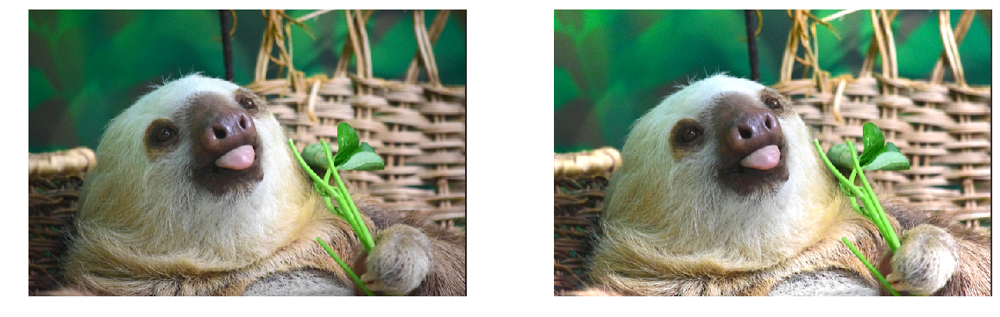

In [241]:
def lighten_edges(img):
    light = img
    M, N, D = get_shape(img)
    lighter = circle_mask(M,N)
    for d in range (0, D - 1):
        light[:,:,d] /= lighter
        for x in range(0, M):
            for y in range(0, N):
                if (light[x][y][d] > 1):
                    light[x][y][d] = 1
    return (light)

diff_blep(lighten_edges)

Part 2: Amaro

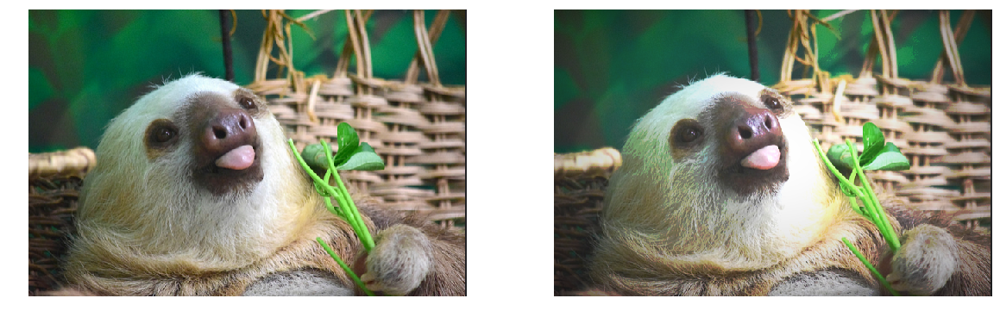

In [242]:
def amaro(img):
    return (darken_edges(lighter(more_contrast(img))))

diff_blep(amaro)

Part 2: Mayfair

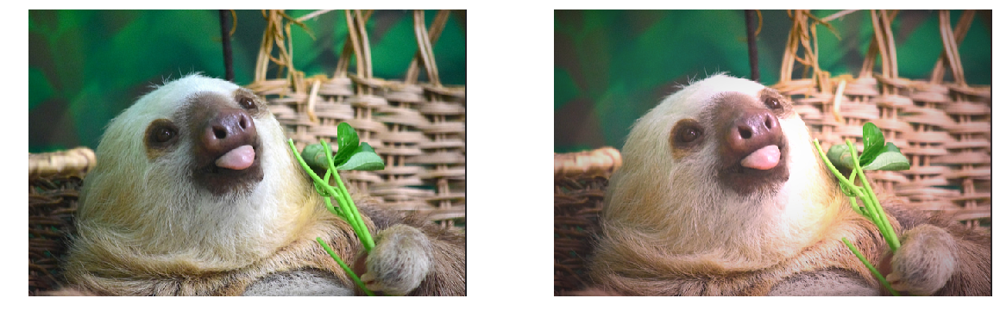

In [243]:
def mayfair(img):
    return (darken_edges(redder(lighter(img))))

diff_blep(mayfair)

Part 2: Rise

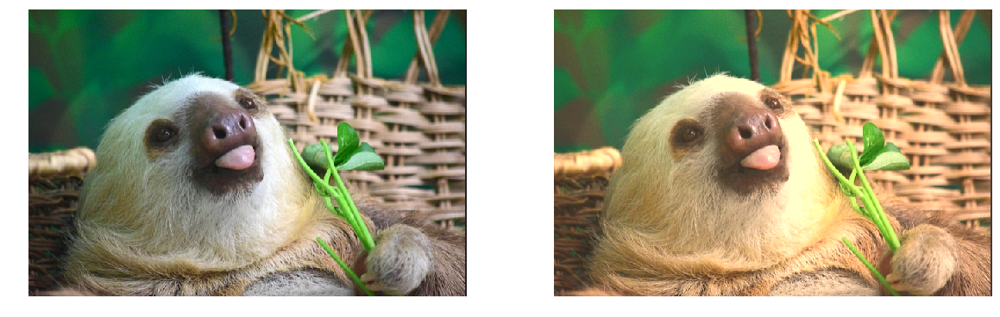

In [244]:
def rise(img):
    return(redder(yellowish(lighter(img))))

diff_blep(rise)

Part 2: Hudson

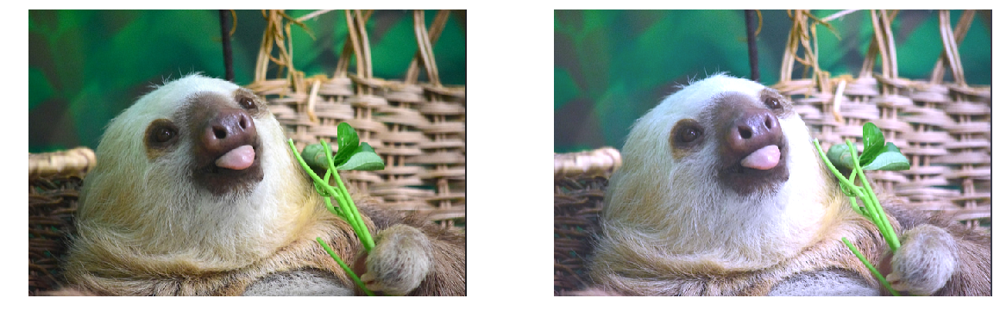

In [245]:
def hudson(img):
    return(bluer(lighter(img)))

diff_blep(hudson)

Part 2: Valencia

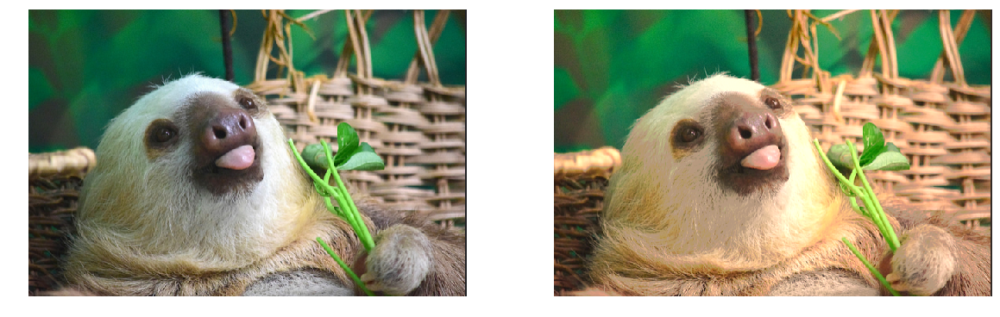

In [246]:
def valencia(img):
    return(redder(yellower(less_contrast(img))))

diff_blep(valencia)

Part 2: X-Pro II

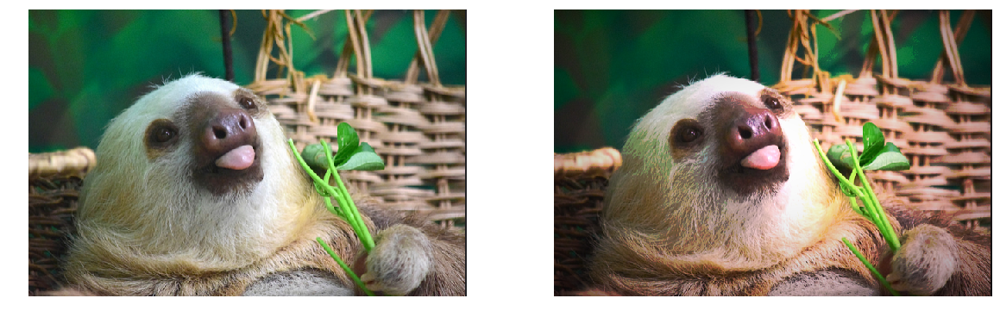

In [247]:
def xproii(img):
    return(darken_edges(redder(more_contrast(img))))

diff_blep(xproii)

Part 2: Sierra

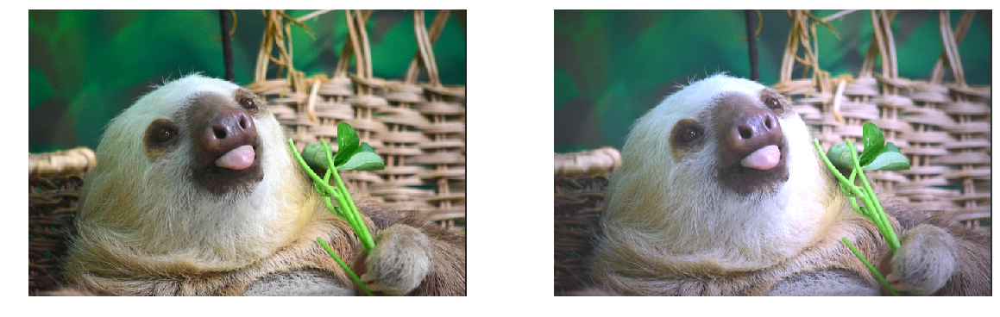

In [248]:
def sierra(img):
    return(lighter(darken_edges(bluer(img))))

diff_blep(sierra)

Part 2: Willow

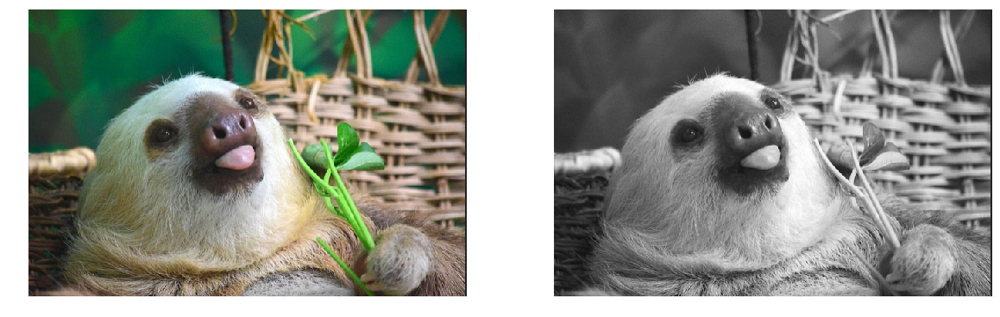

In [249]:
def willow(img):
    return(natural_greyscale(bluer(redder(img))))

diff_blep(willow)

Part 2: Earlybird

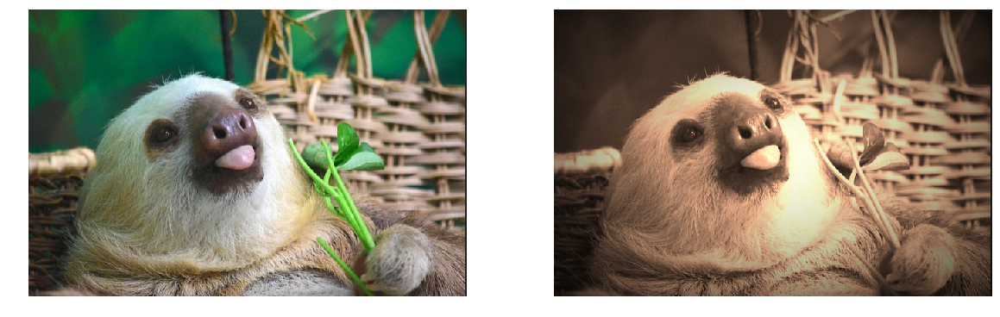

In [250]:
def earlybird(img):
    return(darken_edges(darken_edges(redder(sepia(img)))))

diff_blep(earlybird)

Part 2: Sutro

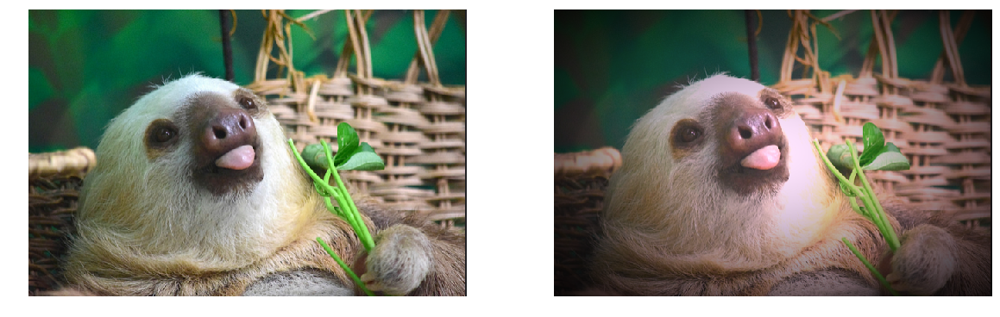

In [251]:
def sutro(img):
    return(darken_edges(darken_edges(darken_edges(lighter(redish(yellower(img)))))))

diff_blep(sutro)

Part 2: Toaster

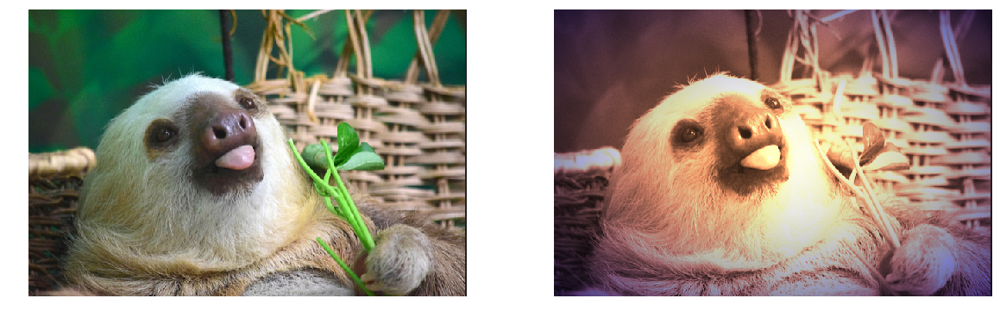

In [252]:
def toaster(img):
    return (((bluer_edges(bluer_edges(redder(redder((yellower((sepia(img)))))))))))

diff_blep(toaster)

Part 2: Brannan

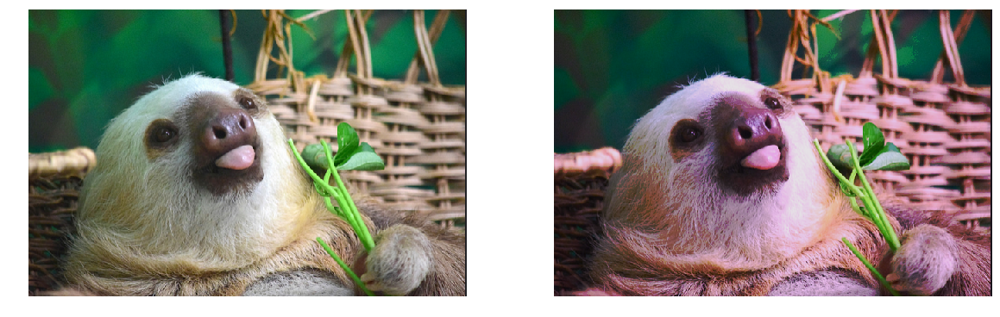

In [253]:
def brannan(img):
    return(darker(more_contrast(lighter(redish(img)))))
    
diff_blep(brannan)

Part 2: Inkwell

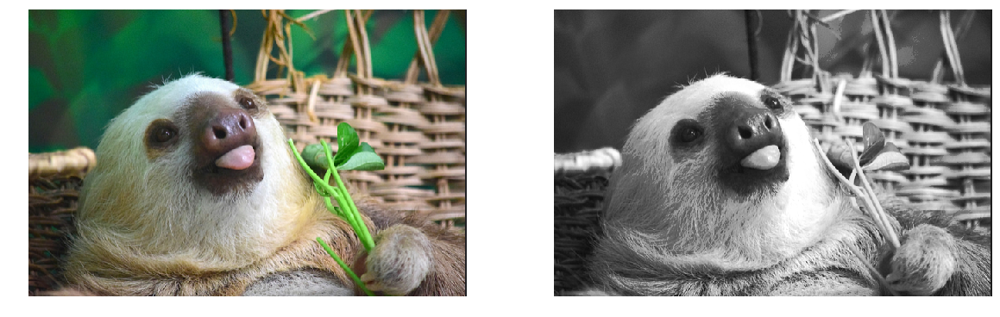

In [254]:
def inkwell(img):
    return(natural_greyscale(more_contrast(img)))

diff_blep(inkwell)

Part 2: Walden

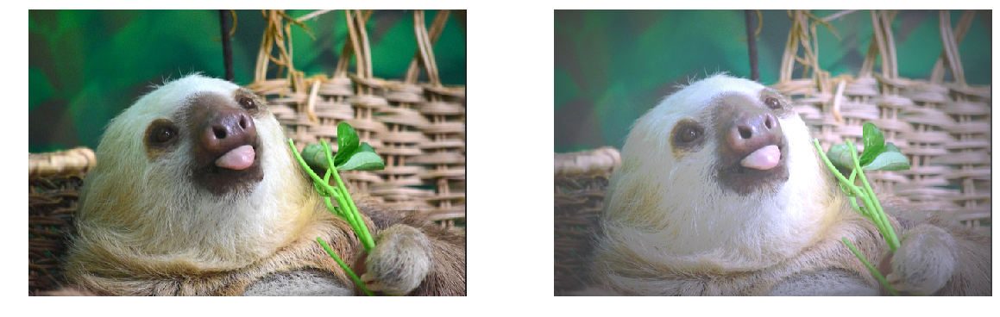

In [255]:
def walden(img):
    return(lighter(lighter(darken_edges(darken_edges(less_contrast(bluer(img)))))))

diff_blep(walden)

Part 2: Hefe

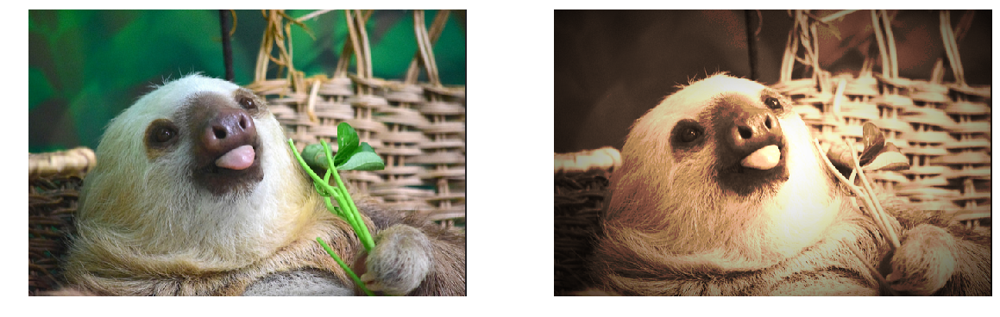

In [256]:
def hefe(img):
    return(darken_edges(darken_edges(more_contrast(redder(sepia(img))))))
    
diff_blep(hefe)

Part 2: Nashville

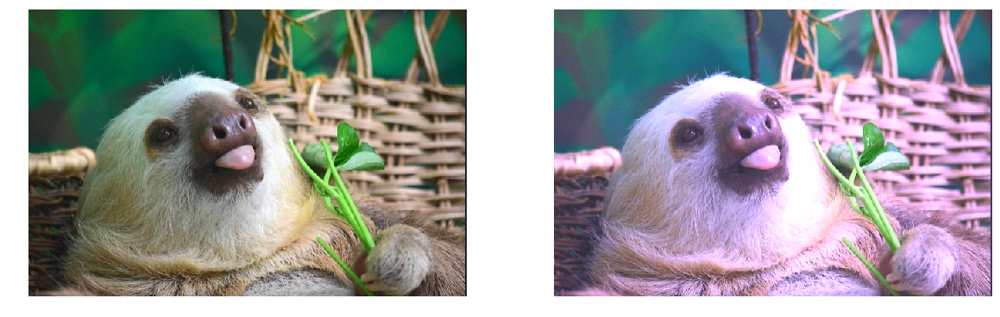

In [257]:
def nashville(img):
    return(bluer(bluer(lighter(redder(img)))))

diff_blep(nashville)

Part 2: 1977

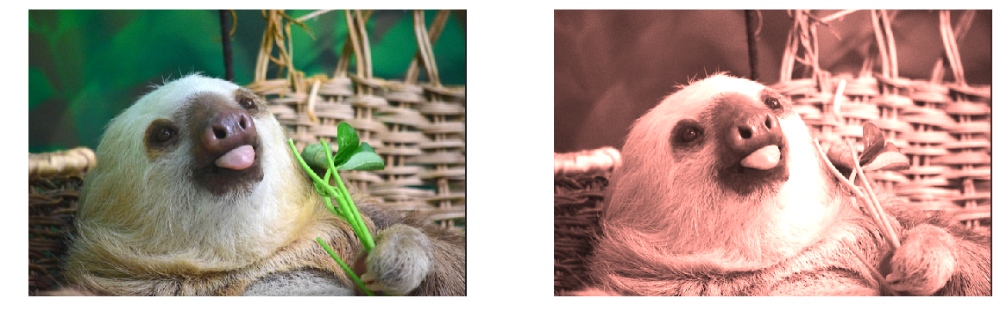

In [258]:
def nineteenseventyseven(img):
    return(redder(redder(bluer(sepia(img)))))
    
diff_blep(nineteenseventyseven)

Part 2: Kelvin

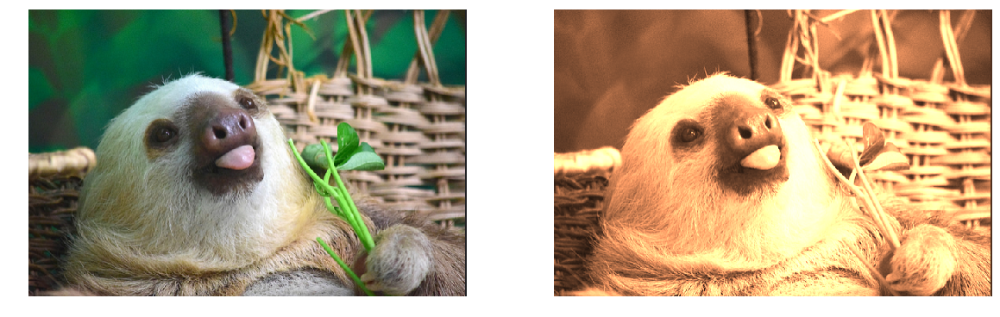

In [259]:
def kelvin(img):
    return (redder(redder(yellower(sepia(img)))))

diff_blep(kelvin)